# Figure 3 - scRNA-seq Analysis

Analysis to generate figures found in figure 3 of Inge _et al. (Dev. Cell. 2025)_

Initial alignment was performed using cellrangers and initial pipeline can be found in `scRNAseq_pipeline.ipynb`

In [4]:
import pandas as pd
import matplotlib
import matplotlib.pyplot as plt
import seaborn as sns

import warnings
warnings.filterwarnings("ignore")

import scanpy as sc
sc.settings.set_figure_params(dpi=2000, facecolor='white')

ingeo_colours = ["#0077BB","#33BBEE","#009988","#EE7733","#CC3311","#EE3377","#BBBBBB","#5D3FD3"]

import matplotlib.pyplot as plt
import numpy as np
from matplotlib.colors import LinearSegmentedColormap

def create_color_scale(base_color):
    cmap = LinearSegmentedColormap.from_list(
        'color_scale',
        [(0, 'white'), (1, base_color)],
        N=256
    )
    return cmap


## Figure 3A.

Illustrator Schematic of scRNA-seq pipeline

## Import data


In [2]:
adata = sc.read_h5ad("fs_integrated_clean.h5ad")


In [3]:
highlevel_labels = {
    "0": "Pluripotent_1",
    "9": "Pluripotent_2",
    "10": "Pluripotent_3",
    "3": "Mesendoderm",
    "8": "Nascent_Mesoderm",
    "1": "Emergent_Mesoderm_1",
    "11": "Advanced_Mesoderm",
    "5": "Emergent_Mesoderm_2",
    "4": "Endoderm",
    "2": "PGCLCs",
    "7": "Amnion_1",
    "6": "Amnion_2"
    
}
adata.obs["Cell_Types_Fine"] = adata.obs["louvain"].map(highlevel_labels)
highlevel_labels = {
    "0": "Pluripotent",
    "9": "Pluripotent",
    "10": "Pluripotent",
    "3": "Mesendoderm",
    "8": "Mesoderm",
    "1": "Mesoderm",
    "11": "Mesoderm",
    "5": "Mesoderm",
    "4": "Endoderm",
    "2": "PGCLCs",
    "7": "Amnion",
    "6": "Amnion"
    
}
adata.obs["Cell_Types_Coarse"] = adata.obs["louvain"].map(highlevel_labels)

## Figure 3B - UMAP

In [4]:
sc.pl.umap(adata, color=['Cell_Types_Coarse'], frameon=False,
           palette={
        "Pluripotent": ingeo_colours[6],
               "Mesendoderm": ingeo_colours[7],
               "Endoderm": ingeo_colours[0],
               "PGCLCs": ingeo_colours[3],
               "Amnion": ingeo_colours[2],
               "Mesoderm": ingeo_colours[4]
    }, save='_umap_coarse.pdf')


In [5]:
pal={
    "Pluripotent_1": ingeo_colours[6],
     "Pluripotent_2": '#DDDDDD',
    "Pluripotent_3": '#999999',
     "Mesendoderm": ingeo_colours[7],
     "Endoderm": ingeo_colours[0],
     "PGCLCs": ingeo_colours[3],
     "Amnion_1": '#00B2A2', 
     "Amnion_2": '#007E6D',
     "Nascent_Mesoderm":'#E96A56',
     "Emergent_Mesoderm_1":'#A62309',
     "Advanced_Mesoderm":'#881D07',
     "Emergent_Mesoderm_2":'#CC4422'
}

In [6]:
sc.settings.set_figure_params(dpi=1000, facecolor='white')

sc.pl.umap(adata, color=['Cell_Types_Fine'], frameon=False,
           palette=pal, save='_FINE.pdf')


In [7]:
sc.settings.set_figure_params(dpi=1000, facecolor='white')

sc.pl.umap(adata, color=['louvain'], frameon=False, save='_louvain.pdf')


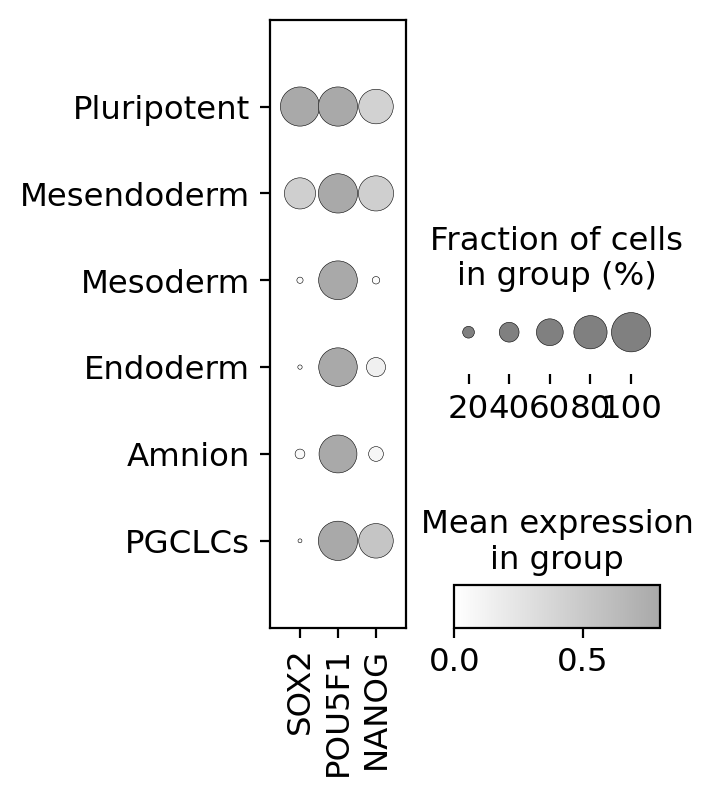

In [8]:
sc.settings.set_figure_params(dpi=100, facecolor='white')


sc.pl.dotplot(adata, ['SOX2','POU5F1','NANOG'], vmin=0,
              vmax=0.8,
              groupby='Cell_Types_Coarse', cmap=create_color_scale('darkgrey'), figsize=(2.5, 4), categories_order=[ 'Pluripotent','Mesendoderm', 'Mesoderm', 'Endoderm', 'Amnion', 'PGCLCs',],
           #  save="Pluri_dotplot'.pdf"
             )


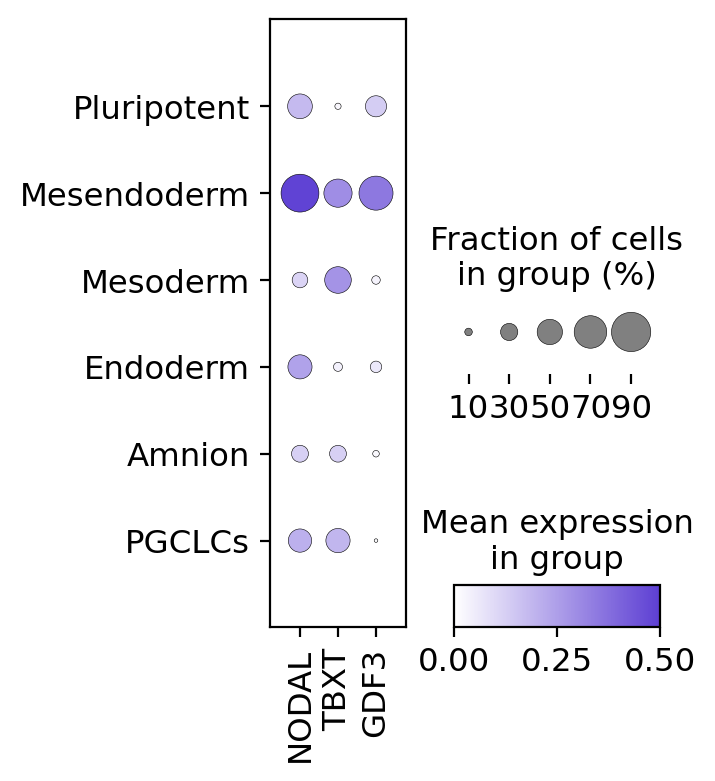

In [9]:
sc.pl.dotplot(adata, ['NODAL','TBXT','GDF3'], vmin=0,
              vmax=0.5,
              groupby='Cell_Types_Coarse', cmap=create_color_scale(ingeo_colours[7]), figsize=(2.5, 4), categories_order=[ 'Pluripotent','Mesendoderm', 'Mesoderm', 'Endoderm', 'Amnion', 'PGCLCs',],
             #save="Mesendoderm_dotplot'.pdf"
             )


In [10]:
sc.tl.embedding_density(adata, groupby='batch')


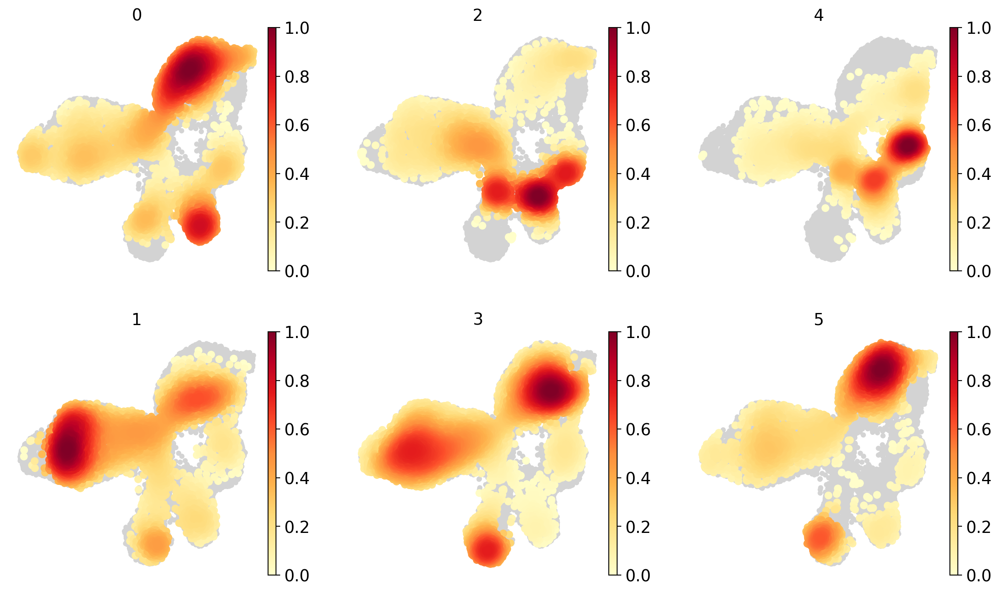

In [11]:
# Set the custom order: first 0, 2, 4, then 1, 3, 5
custom_order = ['0', '2', '4', '1', '3', '5']  # Use strings if batch is categorical

# Ensure 'batch' is categorical and ordered
adata.obs['batch'] = pd.Categorical(adata.obs['batch'], categories=custom_order, ordered=True)

# Plot with 3 columns and no frame
sc.pl.embedding_density(
    adata,
    groupby='batch',
    ncols=3,
    frameon=False,
  #  save="_density.pdf"
)

## Figure 3E.

Initial RNA velocity can be found in `RNAVelocity.ipynb`

In [1]:
import scvelo as scv

In [2]:
path = '/nemo/lab/santoss/home/users/ingeo/Analysis/Single_cell_RNA_seq_projects/2020_fate_switching_OI/2022_finalised_analysis/RNA_velocity_rerun_23/Full_scvelo_dataset.h5ad'

In [5]:
adata = sc.read(path)


In [6]:
highlevel_labels = {
    "0": "Pluripotent_1",
    "9": "Pluripotent_2",
    "10": "Pluripotent_3",
    "3": "Mesendoderm",
    "8": "Nascent_Mesoderm",
    "1": "Emergent_Mesoderm_1",
    "11": "Advanced_Mesoderm",
    "5": "Emergent_Mesoderm_2",
    "4": "Endoderm",
    "2": "PGCLCs",
    "7": "Amnion_1",
    "6": "Amnion_2"
    
}
adata.obs["Cell_Types_Fine"] = adata.obs["louvain"].map(highlevel_labels)


highlevel_labels = {
    "Pluripotent_1": "Pluripotent",
    "Pluripotent_2": "Pluripotent",
    "Pluripotent_3": "Pluripotent",
    "Mesendoderm": "Mesendoderm",
    "Nascent_Mesoderm": "Mesoderm",
    "Emergent_Mesoderm_1": "Mesoderm",
    "Advanced_Mesoderm": "Mesoderm",
    "Emergent_Mesoderm_2": "Mesoderm",
    "Endoderm": "Endoderm",
    "PGCLCs": "PGCLCs",
    "Amnion_1": "Amnion",
    "Amnion_2": "Amnion"
    
}
adata.obs["Cell_Types_Coarse"] = adata.obs["Cell_Types_Fine"].map(highlevel_labels)

computing velocity embedding
    finished (0:00:05) --> added
    'velocity_umap', embedded velocity vectors (adata.obsm)


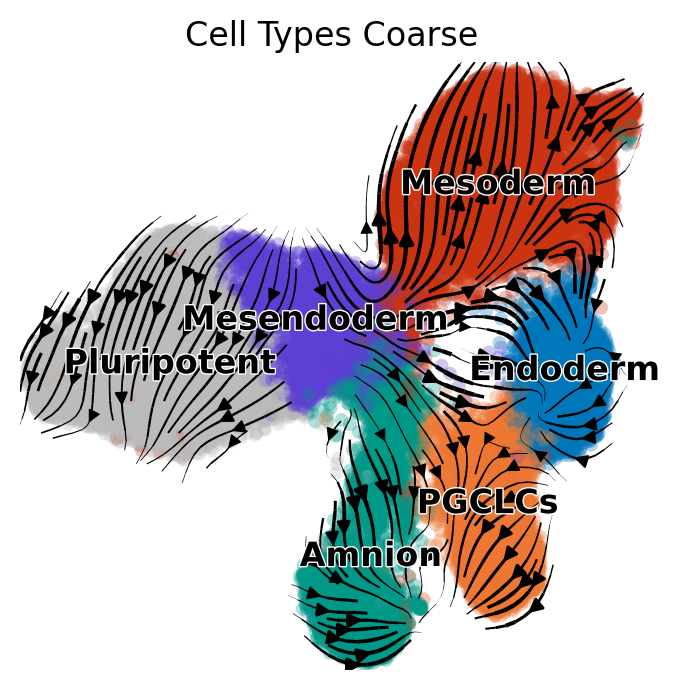

In [7]:
scv.settings.set_figure_params('scvelo')  # 

scv.pl.velocity_embedding_stream(adata, basis='umap', color="Cell_Types_Coarse",  palette={
        "Pluripotent": ingeo_colours[6],
               "Mesendoderm": ingeo_colours[7],
               "Endoderm": ingeo_colours[0],
               "PGCLCs": ingeo_colours[3],
               "Amnion": ingeo_colours[2],
               "Mesoderm": ingeo_colours[4]
    }, figsize=(4,4))


## Figure 3F - RNA Velocity Bifurcation

In [26]:
path = '/nemo/lab/santoss/home/users/ingeo/Analysis/Single_cell_RNA_seq_projects/2020_fate_switching_OI/2022_finalised_analysis/RNA_velocity_rerun_23/bifurcation_pca_subset.h5ad'


# adata_subset = adata[adata.obs['Cell_Types_Coarse'].isin(['Mesendoderm','Mesoderm', 'Endoderm'
# ])]

# sc.pp.neighbors(adata_subset)

# sc.tl.pca(adata_subset)
# sc.tl.umap(adata_subset)
# sc.tl.diffmap(adata_subset)

adata_subset = sc.read(path)

scv.pp.moments(adata_subset, n_pcs=30, n_neighbors=30)
scv.tl.velocity(adata_subset)
scv.tl.velocity_graph(adata_subset)



Normalized count data: spliced, unspliced.
computing neighbors
    finished (0:00:02) --> added 
    'distances' and 'connectivities', weighted adjacency matrices (adata.obsp)
computing moments based on connectivities
    finished (0:00:02) --> added 
    'Ms' and 'Mu', moments of un/spliced abundances (adata.layers)
computing velocities
    finished (0:00:03) --> added 
    'velocity', velocity vectors for each individual cell (adata.layers)
computing velocity graph (using 1/256 cores)


  0%|          | 0/12794 [00:00<?, ?cells/s]

    finished (0:00:29) --> added 
    'velocity_graph', sparse matrix with cosine correlations (adata.uns)


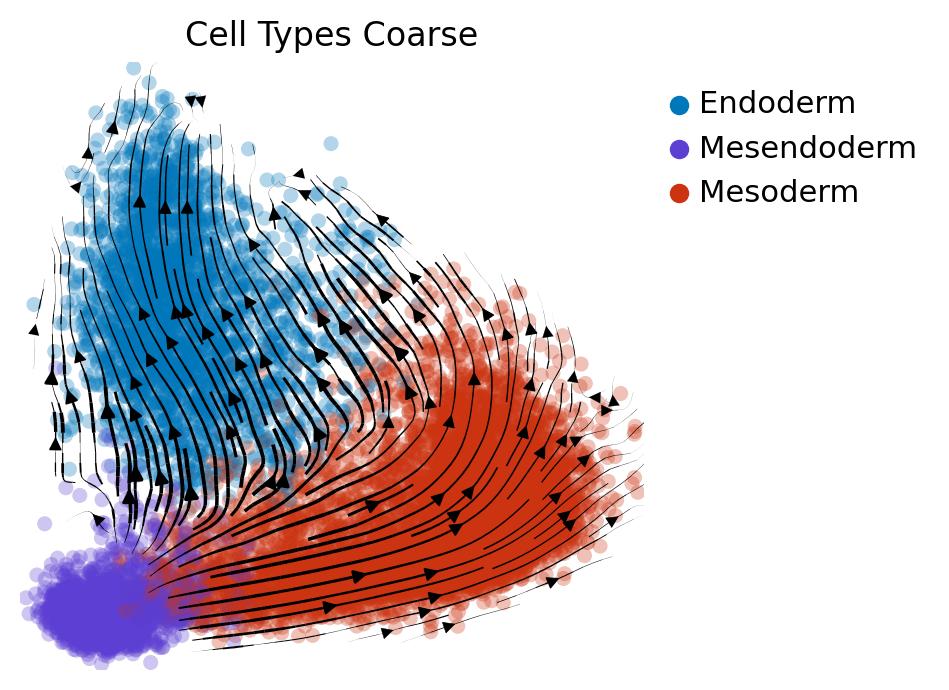

In [28]:
scv.pl.velocity_embedding_stream(adata_subset,
                                 basis='pca', color='Cell_Types_Coarse', palette={
        "Pluripotent": ingeo_colours[6],
               "Mesendoderm": ingeo_colours[7], # relabelled as primitive streak in study.
               "Endoderm": ingeo_colours[0],
               "Mesoderm": ingeo_colours[4]
    }, smooth=0.5, density=2, figsize=(4,4), legend_loc=None  )





## Figure 3G - RNA Velocity Bifurcation Gene expression

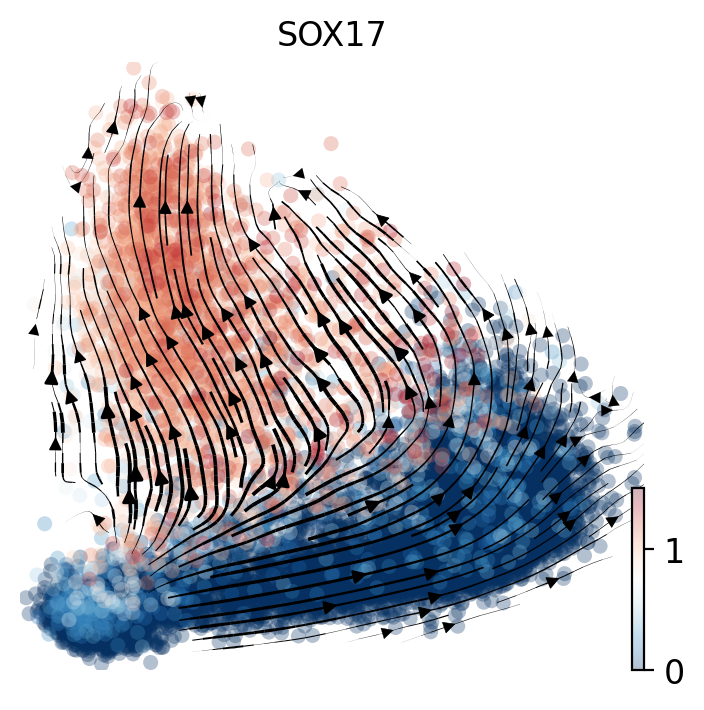

In [32]:
## Example SOX17

scv.pl.velocity_embedding_stream(
    adata_subset,
    basis='pca',
    color='SOX17',  
    color_map='RdBu_r',   
    smooth=0.5,
    density=2,
    figsize=(4, 4),
    legend_loc=None
)

## Figure 3H - CellRank analysis

Cell Rank analysis can be found in script `Figure_3H_CR.ipynb`

## Figure 3I - Slingshot and tradeSeq

Slingshot and tradeSeq analysis can be found in scripts in folder `TradeSeq_Slingshpt

## Figure 3J - Slingshot MAGIC

Slingshot pseudotimes can be found in script `Figure_3J_MAGIC.ipynb`

## Figure 3K-L - Coexpression

Slingshot pseudotimes can be found in script `Figure_3J_MAGIC.ipynb`